# Curso de Big Data

## Trabajo Práctico 3

### Samuel Arispe, Gonzalo Ochoa y Facundo Valle Quintana

### Reglas de formato y presentación
- El trabajo debe estar bien comentado (utilizando #) para que el código sea fácil de entender por sus compañeros y profesores.

- El mismo debe ser completado en este Jupyter Notebook y entregado como tal, es decir en un archivo .ipynb


### Fecha de entrega:
Domingo 5 de noviembre a las 23:59hs

### Contenidos:


Analizar el problema del no reporte de ingresos en las encuestas de hogares y cómo eso afecta la medición de la tasa de pobreza. Se profundizará en el análisis de esta temática con los nuevos métodos vistos en clase para identificar individuos sin reporte de ingresos.

### Modalidad de entrega
- Al finalizar el trabajo práctico deben hacer un último <i>commit</i> en su repositorio de GitHub con el mensaje “Entrega final del tp”.

- Asegurense de haber creado una carpeta llamada TP3. Deben entregar el código (jupyter notebook).

- También deben completar el link de su repositorio -para que pueda ser clonado y corregido- en la siguiente <a href="https://docs.google.com/spreadsheets/d/1v8Sv2TSzpK6mxjm3mmdnhmkk0qiyGFNj/edit#gid=1820558252">google sheet</a>

- La última versión en el repositorio es la que será evaluada. Por lo que es importante que:
    - No completen la google sheet hasta no haber terminado y estar seguros de que han hecho el <i>commit y push</i> a la versión final que quieren entregar. Debido a que se pueden tomar hasta 3 días de extensión a lo largo del curso, no se  corregirán sus tareas hasta no ver el link en la google sheet.\
    
    - No hagan nuevos <i>push</i> despues de haber entregado su versión final. Esto generaría confusión acerca de que versión es la que quieren que se les corrija.

### Reglas de formato y presentación

- El trabajo se debe entregar como Jupyter Notebook. Se espera una buena redacción en la resolución del práctico.

- Identifiquen claramente a qué inciso corresponde cada comando y, cuando sea necesario, usen bloques de texto para detallar sus respuestas.

- Importante: Todos los miembros del equipo deben haber hecho al menos un <i> commit </i> durante la realización del TP para asegurar que todos hayan aportado a su resolución.

## Parte I: Análisis de la base de hogares y cálculo de pobreza

Ahora que ya se han familiarizado con la Encuesta Permanente de Hogares (EPH) y
con la tabla de adulto equivalente, vamos a complejizar un poco la construcción del índice de pobreza. Lo calcularemos a nivel de hogares, con sus respectivos factores de expansión y realizaremos una limpieza de la base con mayor dedicación.
A continuación, complementamos el trabajo hecho en el TP2 usando la encuesta a
nivel hogares de la EPH.

#### 1. Exploren el diseño de registro de la base de hogar: a priori, ¿qué variables creen que pueden ser muy predictivas de pobreza y que sería muy útil incluir para perfeccionar el ejercicio del TP2?

Respuesta: A la hora de perfeccionar la predicción de la pobreza del TP2, consideramos que las siguientes variables pueden ser relevantes:

1. <b>Identificación</b>: retendríamos todas las variables, ya que nos permiten ubicar espacial y temporalmente a la pobreza.
<br>

2. <b>Características de la vivienda</b>: retendríamos las siguientes variables: IV1, IV2, V4, IV7, IV8, IV10, IV11, IV12_3, dado que identifican considiciones habitacionales subóptimas, que son claves determinantes de la pobreza siguiendo la lógica de Amartya Sen.
<br>

3. <b>Características habitacionales</b>: retendríamos las siguientes variables: II1, II3, II8, II9, V1, V2, V4, V5, V6, V12, V19_A, V19_B, IX_ToT, ITF, DECIFR, IPCF, DECCFR. Este conjunto de variables nos permite indagar sobre las dimensiones del hogar, el funcionamiento de sus baños y la fuente de los ingresos familiares lo que nos permite identificar a las personas más vulnerables.

#### 2. Descarguen la base de microdatos de la EPH correspondiente al primer trimestre de 2023 (la base de hogares se llama usu hogar T123.xls). Importen los datos de la encuesta de hogar y, al igual que en el TP2, conserven sólo las observaciones que corresponden a los aglomerados de Ciudad Autónoma de Buenos Aires o del Gran Buenos Aires.

In [1]:
import pandas as pd
import numpy as np
np.random.seed(201)
import matplotlib.pyplot as plt
import statsmodels.api as sm

%matplotlib inline
#from ISLP import load_data
from sklearn.preprocessing import scale
from sklearn.linear_model import Lasso, LassoCV, Ridge, RidgeCV
from sklearn.metrics import mean_squared_error
from sklearn import datasets
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import accuracy_score, recall_score
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import RocCurveDisplay
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import KFold
from tabulate import tabulate
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
import seaborn as sns
import statistics

In [2]:
# Cargamos la data
data_ind = pd.read_excel("usu_individual_T123.xlsx")
data_hog = pd.read_excel("usu_hogar_T123.xlsx")

In [3]:
#Filtrar datos para el área de Buenos Aires tanto a nivel individual como a nivel hogares
data_ind_baires = data_ind[data_ind['AGLOMERADO'].isin([32, 33])]
data_hog_baires = data_hog[data_hog['AGLOMERADO'].isin([32, 33])]

#### 3. Unan la tabla de la encuesta individual con la de la encuesta de hogar.

In [4]:
#Unimos los dos dataframes
#Se incluirán todas las filas de ambos DataFrames, conservando todas las filas aunque no haya coincidencias en las columnas de unión
data_unida = pd.merge(data_ind_baires, data_hog_baires, on=['CODUSU','NRO_HOGAR'], how='outer')

# Seleccionar las columnas que tienen el sufijo a borrar
variables_duplicadas = data_unida.filter(like='_y', axis=1)

# Borrar las columnas seleccionadas del DataFrame
data_unida = data_unida.drop(variables_duplicadas.columns, axis=1)

#### 4. Generen sus propias funciones para limpiar la base de datos o, si deciden utilizar funciones existentes en paquetes como numpy y pandas, mencionen cúales usarán y de qué paquetes son.

In [5]:
# Borramos todas las variables que tienen mas del 50% de missings
proporcion_missing_values = data_unida.isnull().mean()

# Filtra las columnas que tienen más del 50% de missing values
#   todas las variables relacionadas los desocupados tienen mas del 70% de NaN
#   todas las variables relacionadas a los ocupados tienen mas del 50% de NaN
#   Tambien eliminamos las variables relacionadas a la categoría otros y CH14 que se refiere al último año que aprobó, que es redundante dado que ya tenemos nivel educativo (NIVEL_ED).
columnas_50_missing = proporcion_missing_values[proporcion_missing_values > 0.5].index
print(columnas_50_missing)
# Eliminar las columnas seleccionadas del DataFrame
data_unida_drop50 = data_unida.drop(columnas_50_missing, axis=1)

data_unida_drop50['CH08'].fillna(9, inplace=True)
# Sólo reemplazamos esta variable con NS/NR  ya que solo tiene un missing value.
# P47T tiene 24 missing values pero es una variable de ingreso y luego será eliminada

data_unida_drop50['CH08'] = data_unida_drop50['CH08'].astype('int64')

Index(['CH14', 'CH15_COD', 'CH16_COD', 'IMPUTA', 'PP03C', 'PP03D', 'PP3E_TOT',
       'PP3F_TOT', 'PP03G', 'PP03H',
       ...
       'PDECINDR', 'IDECIFR_x', 'PDECIFR_x', 'IDECCFR_x', 'PDECCFR_x',
       'IV1_ESP', 'IV3_ESP', 'IV7_ESP', 'II7_ESP', 'II8_ESP'],
      dtype='object', length=107)


#### 5. Limpien la base de datos tomando criterios que hagan sentido, tanto para el tratamiento de valores faltantes, de outliers, como así también decidan qué variables categóricas y strings usarán y transfórmenlas de forma que haga sentido para los ejercicios siguientes. Justifiquen sus decisiones.

In [6]:
variables_a_verificar = ['IV2','II1','IX_TOT','IX_MEN10','IX_MAYEQ10','ITF_x','CH06','CH12','NIVEL_ED']
# Vemos que CH6=Edad tiene valores negativos, por lo tanto se elimina esas observaciones
# Así como las observaciones que tienen 99 en variables numericas discretas que claramente son missing; menos la edad puede ser 99
data_unida_drop50[variables_a_verificar].describe().T

,count,mean,std,min,25%,50%,75%,max
IV2,7619.0,3.075338,1.933210,1.0,2.0,3.0,4.0,99.0
II1,7619.0,3.056307,1.928454,0.0,2.0,3.0,4.0,99.0
IX_TOT,7619.0,3.696417,1.852985,1.0,2.0,4.0,5.0,13.0
IX_MEN10,7619.0,0.601391,0.947037,0.0,0.0,0.0,1.0,8.0
IX_MAYEQ10,7619.0,3.095026,1.441937,1.0,2.0,3.0,4.0,10.0
ITF_x,7619.0,138407.892637,334941.671900,0.0,0.0,75000.0,200000.0,10990000.0
CH06,7619.0,37.177845,22.738454,-1.0,18.0,35.0,55.0,99.0
CH12,7619.0,4.093451,2.942823,0.0,2.0,4.0,6.0,99.0
NIVEL_ED,7619.0,3.799842,1.746307,1.0,3.0,4.0,5.0,7.0


<Axes: xlabel='variable', ylabel='value'>

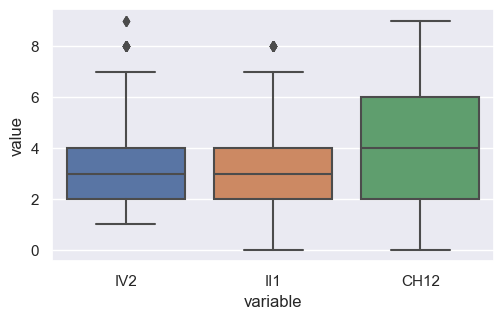

In [7]:
# Chequeamos variables numericas discretas con 99
variables_a_verificar = ['IV2','II1','CH12']  # Lista de variables a verificar
# Utiliza el método drop para eliminar las filas que cumplan con la condición
data_unida_drop50 = data_unida_drop50.drop(data_unida_drop50[(data_unida_drop50[variables_a_verificar] == 99).any(axis=1)].index)

sns.set(rc={'figure.figsize':(5.7,3.27)})
sns.boxplot(x="variable", y="value", data=pd.melt(data_unida_drop50[variables_a_verificar]))

In [8]:
# Obervaciones con valores negativos en variables que no corresponde
variables_negativas = ['CH06']
data_unida_drop50 = data_unida_drop50.drop(data_unida_drop50[(data_unida_drop50[variables_negativas] < 0).any(axis=1)].index)

# Le damos formato de variables categóricas a las variables resepctivas con Sí, No, o categorías diferentes.

variables_categoricas = ['IV1','IV2','IV3','IV4','IV5','IV6','IV7','IV8','IV9','IV10',
                         'IV11','IV12_1','IV12_2','IV12_3','II3','II4_1','II4_2',
                         'II4_3','II5','II6','II7','II8','II9','V1','V2','V21',
                         'V22','V3','V4','V5','V6','V7','V8','V9','V10','V11',
                         'V12','V13','V14','V15','V16','V17','V18','V19_A','V19_B',
                         'CH03','CH04','CH07','CH08','CH09','CH10','CH11','CH13','CH15',
                         'CH16','ESTADO','CAT_OCUP','CAT_INAC','PP02C1','PP02C2',
                         'PP02C3','PP02C4','PP02C5','PP02C6','PP02C7','PP02C8',
                         'PP02E','PP02H','PP02I']

# Volvemos categóricas todas estas varaibles seleccionadas
data_unida_drop50[variables_categoricas] = data_unida_drop50[variables_categoricas].astype('category')
#data_unida_drop50[variables_categoricas].info()

for columna in variables_categoricas:
    dummies = pd.get_dummies(data_unida_drop50[variables_categoricas][columna], prefix=columna)
    data_unida_drop50 = pd.concat([data_unida_drop50, dummies], axis=1)

<Axes: xlabel='variable', ylabel='value'>

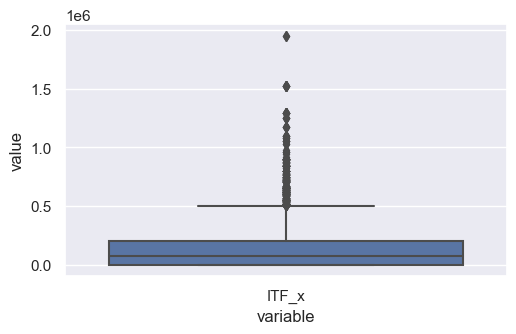

In [9]:
# De las variables de ingreso solo vemos la variable de ingreso total porque después se eliminarán todas las variables relacionadas a ingresos
# La variable de ingreso del hogar tiene outlier (10990000), que puede distorsionar todo. Solo eliminamos esas observaciones
ingreso = ['ITF_x']  # Lista de variables a verificar
data_unida_drop50 = data_unida_drop50.drop(data_unida_drop50[(data_unida_drop50[ingreso] >= 10990000).any(axis=1)].index)

sns.set(rc={'figure.figsize':(5.7,3.27)})
sns.boxplot(x="variable", y="value", data=pd.melt(data_unida_drop50[ingreso]))

#### 6. Presenten estadísticas descriptivas de cinco variables de la encuesta de hogar que ustedes creen que pueden ser relevantes para predecir pobreza.

In [10]:
#calculamos las estadísticas descriptivas para estas variables:

#CH06: Años cumplidos
#IX_TOT: Cantidad de miembros en el hogar
#CH12: Nivel de estudios más alto que cursa o que cursó
#IPCF_x: Monto del ingreso per cápita familiar
#NIVEL_ED: Nivel educativo

variables = ['CH06', 'IX_TOT', 'CH12', 'IPCF_x', 'NIVEL_ED']

resultados = []
for var in variables:
    promedio = data_unida_drop50[var].mean()
    mediana = data_unida_drop50[var].median()
    desviacion_estandar = data_unida_drop50[var].std()
    minimo = data_unida_drop50[var].min()
    maximo = data_unida_drop50[var].max()
    resultados.append([var, promedio, mediana, desviacion_estandar, minimo, maximo])

data_unida_drop50[variables].describe().T

,count,mean,std,min,25%,50%,75%,max
CH06,7560.0,37.409921,22.604266,1.0,18.0,36.00,55.0,99.0
IX_TOT,7560.0,3.690079,1.853650,1.0,2.0,4.00,5.0,13.0
CH12,7560.0,4.067063,1.961361,0.0,2.0,4.00,6.0,9.0
IPCF_x,7560.0,46105.922823,73415.171857,0.0,0.0,20142.86,65000.0,980000.0
NIVEL_ED,7560.0,3.778836,1.733548,1.0,3.0,4.00,5.0,7.0


<b>CH06</b>: Vemos que la edad promedio de nuestra muestra es de 37 años, con un considerable desvío estándar de 22 (esperable); el último cuartil arranca en los 55 años, con un dato máximo de 99 años.
<br>

<b>IX_TOT</b>: La cantidad de miembros en el hogar promedio de nuestra muestra es de 3, inclinándose ligeramente hacia 4; con un desvío estándar de 1.85, estos resultados son los esperados para un país como argentino. Cabe mencionar el máximo de 13 encontrado, muy alejado del resto.
<br>

<b>CH12</b>: Vemos que el nivel educativo en curso/cursado es en promedio el secundario (4.06). Con un desvío estándar de casi 2, podemos interpretar que la gran mayoría de la población completó el primario y terciario, los universitarios y posgrados universitarios siendo outliers.
<br>

<b>IPCF_x</b>: Para el Ingreso Per Cápita Familiar (IPCF) apreciamos que el promedio es de $46,000, con un desvío que supera los $73,000 sugiriendo una importante dispersión de los datos, y entonces desigualdad en los ingresos, hipótesis reforzada por los resultados de los cuartiles: del 2do cuartil al tercero hay una diferencia de casi $40,000 y encontramos un valor máximo de $980,000.
<br>

<b>NIVEL_ED</b>: En el nivel educativo, encontrao,s que el promedio de la población no alcanza el secundario completo (4). Además, vemos que la gran cantidad de nuestra muestra (hasta el 3er cuartil) solamente alcanza el superior universitario incompleto (5), sugiriendo que el universitario completo y los posgrados y doctorados son verdaderos outliers en Argentina.
<br>


#### 7. Repitan el inciso 1.2.f del TP2 para construir la columna <i>adulto_equiv</i> y la columna <i>ad_equiv_hogar</i> (pueden utilizar su código del TP2).

Volvemos a emplear nuestro código del TP2.

In [11]:
#cargamos los datos y renombramos las columnas
data_adult=pd.read_excel("tabla_adulto_equiv.xlsx", header = 4, nrows=23, ) #formateamos para que se cargue correctamente la base.
data_adult.rename({'Unnamed: 0':'Edad','Unnamed: 1':'Mujeres','Unnamed: 2':'Hombres'}, axis=1, inplace = True) # Renombramos las columnas.

In [12]:
def calcular_adulto_equiv(sexo, edad): # Esta función toma dos argumentos: el sexo y la edad. Mediante un "if" filtra primero por sexo y luego por edad, para devolvernos el valor de adulto equivalente correspondiente.
    # para los hombres:
    if sexo == 1:
        if edad < 1:
            return 0.35
        elif edad == 1:
            return 0.37
        elif edad == 2:
            return 0.46
        elif edad == 3:
            return 0.51
        elif edad == 4:
            return 0.55
        elif edad == 5:
            return 0.6
        elif edad == 6:
            return 0.64
        elif edad == 7:
            return 0.66
        elif edad == 8:
            return 0.68
        elif edad == 9:
            return 0.69
        elif edad == 10:
            return 0.79
        elif edad == 11:
            return 0.82
        elif edad == 12:
            return 0.85
        elif edad == 13:
            return 0.90
        elif edad == 14:
            return 0.96
        elif edad == 15:
            return 1
        elif edad == 16:
            return 1.03
        elif edad == 17:
            return 1.04
        elif 18 <= edad <= 29:
            return 1.02
        elif 30 <= edad <= 45:
            return 1.00
        elif 46 <= edad <= 60:
            return 1.00
        elif 61 <= edad <= 75:
            return 0.83
        elif edad > 75:
            return 0.74
        else:
            print("hay un problema")

    # Para las mujeres:
    elif sexo == 2:
        if edad < 1:
            return 0.35
        elif edad == 1:
            return 0.37
        elif edad == 2:
            return 0.46
        elif edad == 3:
            return 0.51
        elif edad == 4:
            return 0.55
        elif edad == 5:
            return 0.6
        elif edad == 6:
            return 0.64
        elif edad == 7:
            return 0.66
        elif edad == 8:
            return 0.68
        elif edad == 9:
            return 0.69
        elif edad == 10:
            return 0.70
        elif edad == 11:
            return 0.72
        elif edad == 12:
            return 0.74
        elif edad == 13:
            return 0.76
        elif edad == 14:
            return 0.76
        elif edad == 15:
            return 0.77
        elif edad == 16:
            return 0.77
        elif edad == 17:
            return 0.77
        elif 18 <= edad <= 29:
            return 0.76
        elif 30 <= edad <= 45:
            return 0.77
        elif 46 <= edad <= 60:
            return 0.76
        elif 61 <= edad <= 75:
            return 0.67
        elif edad > 75:
            return 0.63
        else:
            print("hay un problema")

# Ahora aplicamos la función a nuestro dataframe, y guardamos el valor que nos arroja la función en una nueva columna.
data_unida_drop50['adulto_equiv'] = data_unida_drop50.apply(lambda row: calcular_adulto_equiv(row['CH04'], row['CH06']), axis=1).copy()

In [13]:
# Agrupamos los datos por "CODUSU" y "NRO_HOGAR," 
# Calculamos la suma del valor del adulto equivalente en cada grupo de hogares
# Agrega ese valor como una nueva columna
data_unida_drop50["ad_equiv_hogar"] = data_unida_drop50.groupby(['CODUSU', 'NRO_HOGAR'])["adulto_equiv"].transform('sum')

#### 8. Repitan el inciso 1.3 y 1.4 del TP2 para dividir la base en dos dataframes donde: uno conserve las personas que no reportaron ITF (dataframe llamado <i> respondieron </i>) y otro conserve a las personas que no reportaron ITF (llamado <i> norespondieron </i>). Además, agreguen a la base respondieron una columna llamada <i>ingreso_necesario</i> que sea el producto de la canasta básica por <i>ad_equiv_hogar</i>.

In [14]:
# Guardamos un dataframe con los datos de las personas que si contestaron.

respondieron = data_unida_drop50[data_unida_drop50["ITF_x"]!=0]

# Guardamos en otro data frame las personas que no respondieron.

norespondieron = data_unida_drop50[data_unida_drop50["ITF_x"]==0]

#### 9. Agreguen a la base respondieron una columna llamada pobre, que tome valor1 si el ITF es menor al ingreso necesario que necesita esa familia y 0 en caso contrario.

In [15]:
#Calculamos un valor basado en el valor del adulto equivalente en el hogar.
def CBT (ad_equiv_hogar):
    return ad_equiv_hogar * 57371.05

#Creamos una Nueva Columna llamada "ingreso_necesario":
respondieron['ingreso_necesario'] = respondieron.apply(lambda row: CBT(row['ad_equiv_hogar']), axis=1).copy()

#Esta función nos indica las personas pobres, cuyo ingreso es menor al necesario.
def polenta(hornero, hornero_necesario):
    if hornero < hornero_necesario:
        return 1
    else:
        return 0

respondieron['pobre'] = respondieron.apply(lambda row: polenta(row['ITF_x'], row['ingreso_necesario']), axis=1)

respondieron['pobre'].value_counts()

C:\Users\cufa9\AppData\Local\Temp\ipykernel_5116\1089956271.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  respondieron['ingreso_necesario'] = respondieron.apply(lambda row: CBT(row['ad_equiv_hogar']), axis=1).copy()
C:\Users\cufa9\AppData\Local\Temp\ipykernel_5116\1089956271.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  respondieron['pobre'] = respondieron.apply(lambda row: polenta(row['ITF_x'], row['ingreso_necesario']), axis=1)


0    2618
1    1555
Name: pobre, dtype: int64

<b>1555</b> personas que respondieron son consideradas pobres, mientras que 2618 no lo son. 
<br>
Esto significa un <b>37.26%</b> de pobreza para nuestra muestra.

#### 10. En el TP2 calcularon los individuos bajo la línea de pobreza. Sin embargo, cuando se habla de pobreza el número más utilizado es el de la tasa de hogares bajo la línea de pobreza. Para calcularlo, utilicen una sola observación por hogar y sumen el ponderador PONDIH que permite expandir la muestra de la EPH al total de la población que representa. ¿Cuál es la tasa de hogares bajo la línea de pobreza para el GBA? ¿Se asemeja al que reporta el  <a href="https://www.indec.gob.ar/uploads/informesdeprensa/eph_pobreza_09_2326FC0901C2.pdf">INDEC en sus informes</a>?



In [16]:
#Creamos base con solo una observacion por hogar
respondieron_hogares=respondieron.groupby(['CODUSU','NRO_HOGAR']).agg({"pobre" : "mean","PONDERA_x" : "sum"})
#Sumamos cuanto hay de cada uno.
sumas=respondieron_hogares.groupby("pobre").PONDERA_x.sum().to_frame()
respondieron_porcentajes = sumas.apply(lambda x:
                                                 100 * x / float(x.sum()))
print(respondieron_porcentajes)

       PONDERA_x
pobre           
0.0    58.705162
1.0    41.294838


Los resultados muestran que, a nivel de hogares, el <b>58.71%</b> de los hogares no se consideran "pobres", mientras que el <b>41.29%</b> de los hogares se consideran "pobres".
<br>

El INDEC en su informe, señala que el porcentaje de hogares bajo la linea de pobreza para el GBA es del <b>30.3%</b>, mucho menor a lo que nosotros calculamos.


## Parte II: Construcción de funciones

El objetivo de esta parte del trabajo es generar código que sea flexible y que esté modularizado (en funciones bien documentadas con docstrings). De esta forma, evitarán repetir código y podrán utilizarlo en distintos escenarios (como por ejemplo la Parte III de este TP y sus proyectos personales a futuro).

#### 1. Escriban una función, llamada <i>evalua_metodo</i>, que reciba como argumentos un modelo y los datos de entrenamiento y prueba (<i>X train </i>, <i> y train </i> , <i>X test</i>, <i>y test</i>). La funcioón debe ajustar el modelo con los datos de entrenamiento y calcular las métricas que considere necesarias para esta problemática (de mínima, deben reportar la matriz de confusión, las curvas ROC y los valores de AUC y de accuracy score de cada método). El output de la función debe ser una colección con las métricas evaluadas.

In [17]:
def evalua_metodo(X_train, X_test, Y_train, Y_test, modelo, landa=1):
    '''
    La función ajusta el modelo con los datos de entrenamiento (x_train, y_train) y
    calcular la matriz de confusión, las curvas ROC, los valores de
    AUC asociados y el Accuracy score de cada método). 
    
    Input:
       
        x_train: Datos de entrenamiento (características) - Conjunto de entrenamiento.
        x_test: Datos de prueba (características) - Conjunto de prueba.
        y_train: Etiquetas de entrenamiento - Valores objetivo del conjunto de entrenamiento.
        y_test: Etiquetas de prueba - Valores objetivo del conjunto de prueba.
        modelo: Modelo de clasificación a evaluar (por ejemplo, LogisticRegression, LinearDiscriminantAnalysis, KNeighborsClassifier).
        landa=1: Parámetro lambda (lambda regularización) para ajustar el modelo (por defecto, 1).

    Output:

        df_metrics: DataFrame que contiene la matriz de confusión, la precisión (Accuracy), el área bajo la curva ROC (AUC) 
        y el error cuadrático medio (ECM).
    '''
    
    if modelo== LogisticRegression:
        y = modelo(max_iter=10000, C=1/landa).fit(X_train, Y_train)
    elif modelo==LinearDiscriminantAnalysis:
        y = modelo().fit(X_train, Y_train)
    elif modelo== KNeighborsClassifier:
        y = modelo(n_neighbors=3).fit(X_train, Y_train)
    else:
        y = modelo.fit(X_train, Y_train)

    Y_pred = y.predict(X_test)
    Y_pred_score = y.predict_proba(X_test)[:,1]

    matriz_confusion = confusion_matrix(Y_test, Y_pred)
    auc = roc_auc_score(Y_test, Y_pred_score)
    fpr, tpr, thresholds = roc_curve(Y_test, Y_pred_score)
    np.set_printoptions(suppress = True)
    plt.figure(figsize=(6, 4))
    plt.plot(fpr, tpr, color='purple', lw=2, label='Area = {:.3f}'.format(auc))
    plt.plot([0, 1], [0, 1], color='gray', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de falsos positivos')
    plt.ylabel('Tasa de verdaderos positivos')
    plt.title('Receiver Operating Characteristic (ROC)')
    plt.legend(loc='lower right')

    accuracy = accuracy_score(Y_test, Y_pred)

    ecm = mean_squared_error(Y_test, Y_pred)

    df_metrics = pd.DataFrame({'modelo': [modelo], 'matriz de confusion': [matriz_confusion] ,'accuracy': ['{:.3f}'.format(accuracy)], 'auc':['{:.3f}'.format(auc)], 'ecm':[ecm]})

    return df_metrics

#### 2. Escriban una función, llamada <i>cross_validation</i>, que realice validación cruzada con <i>k</i> iteraciones (<i>k</i>-fold CV), llamando a la función del inciso anterior en cada una, pero para las <i>k</i> distintas particiones. La función debe recibir como argumentos el modelo, el valor de <i>k</i> y un dataset (es decir, sólo X e y). Pueden ayudarse con la función  <a href="https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.KFold.html">Kfold</a> para generar las particiones necesarias.

In [18]:
def cross_validation(modelo, k, X, y):
    '''
    Esta función aplica la validación cruzada con k iteraciones (k-fold CV), llamando a la función
    "evalua_metodo" cada iteración, pero para las k distintas particiones. 
    
 Inputs:

    modelo: Modelo de clasificación a evaluar (por ejemplo, LogisticRegression, LinearDiscriminantAnalysis, KNeighborsClassifier).
    k: Número de divisiones en la validación cruzada (k-fold CV).
    X: Conjunto de datos de características de entrada.
    y: Etiquetas de salida correspondientes al conjunto de datos de entrada.

    Outputs:

    final_ecm: Error cuadrático medio promedio a través de las k iteraciones de validación cruzada.
    ecm: Lista que contiene el error cuadrático medio de cada iteración de validación cruzada.
    
    '''
    sc = StandardScaler()

    kf = KFold(n_splits=k, shuffle=True, random_state=201)

    ecm = []

    for i, (train_index, test_index) in enumerate(kf.split(X)):
        X_train, X_test = X.iloc[list(train_index)], X.iloc[list(test_index)]
        Y_train, Y_test = y.iloc[list(train_index)], y.iloc[list(test_index)]

        # Estandarizamos las observaciones de entrenamiento
        X_train_transformed = pd.DataFrame(sc.fit_transform(X_train),index=X_train.index, columns=X_train.columns)
        # Estandarizamos las observaciones de test
        X_test_transformed = pd.DataFrame(sc.transform(X_test),index=X_test.index, columns=X_test.columns)

        ecm2 = evalua_metodo(X_train_transformed, X_test_transformed, Y_train, Y_test, modelo) #Aplicamos la función evalua_metodo
        ecm3 = ecm2['ecm'][0]
        ecm.append(ecm3) # Agregamos los resultados

    final_ecm = statistics.mean(ecm) # Computamos las medias.

    return final_ecm, ecm

#### 3. Escriban una función, llamada <i>evalua_config</i> que reciba una lista de configuraciones de hiperparámetros (1) (los distintos valores a probar como hiperparámetros podrían codificarse en diccionarios de Python) y utilizando la función <i>cross_validation</i> obtenga el error (2) promedio para cada configuración. Finalmente, la función debe devolver la configuración que genere menor error (3).

Notas: 

(1) En <i>scikit-learn</i>, muchos métodos llaman penalty al método de regularización y <i>C</i> a la inversa del hiperparámetro <i>λ</i>.

(2) Utilicen la medición del error que prefieran. Una opción sería el Error Cuadrático Medio

(3) Consejo: cuanto más genérica construyan la función, luego podrá ser utilizada en más situaciones. Por ahora, la usaremos solo para buscar el <i>λ</i> óptimo cuando utilicemos regularización.

In [19]:
def evalua_config(landa, k, X, y, l1_ratio=1):
    '''
    Esta función reciba una lista con las configuración de lambda y de las particiones.
    Luego, utilizando la función cross_validation, obtiene el Error Promedio para cada configuración.
    
    Inputs:

    landa: Lista de valores de lambda (parámetro de regularización) a evaluar.
    k: Número de divisiones en la validación cruzada (k-fold CV) para evaluar cada configuración.
    X: Conjunto de datos de características de entrada.
    y: Etiquetas de salida correspondientes al conjunto de datos de entrada.
    l1_ratio: Parámetro l1_ratio que controla el mix de penalizaciones L1 y L2 (por defecto, LASSO (1).

    Outputs:

    minimo_ecm_mean: El valor mínimo del error cuadrático medio promedio encontrado en las configuraciones.
    valor_lambda: El valor de lambda que corresponde al mínimo error cuadrático medio promedio.
    ret: DataFrame que contiene los resultados de ECM y ECM promedio para cada configuración de lambda.

    
    Detalles: 
    Cuando l1_ratio=1: se aplica el método Lasso.
    Cuando l1_ratio=0: se aplica el métodoRidge.
    Si 0 <l1_ratio< 1: se realiza una combinación de ambos (Elastic net).
    '''
    ret=pd.DataFrame(columns=["ecm","ecm_mean","parametro"])

    for i in range(len(landa)):
        clf_en_LR = LogisticRegression(C=1/landa[i], penalty="elasticnet",
                                       solver="saga", l1_ratio=l1_ratio, tol=0.01, random_state=201) # Dadas las características del método "solver" aplicamos una semilla para obtener resultados consistentes.
        ecm_mean  = cross_validation(clf_en_LR, k, X, y)[0]
        ecm       = cross_validation(clf_en_LR, k, X, y)[1]
        ret.loc[i]= [ecm, ecm_mean, landa[i]] # coef

    indice_minimo_ecm = ret['ecm_mean'].idxmin()
    valor_lambda = ret.at[indice_minimo_ecm, 'parametro']
    minimo_ecm_mean = ret['ecm_mean'].min()

    return minimo_ecm_mean, valor_lambda, ret

#### 4. Escriban una función llamada <i>evalua_multiples_metodos</i> que les permita implementar los siguiente métodos con los hiperparámetros que ustedes elijan. Para la regresión logística, asegúrense de que esta función utilice su función <i>evalua_config</i> para optimizar el <i>λ</i> de la regularización. Finalmente, el output de la función debe ser una tabla donde las columnas sean las métricas que hayan evaluado (las que hayan incluido en la función <i>evalua_metodo</i>) y las filas sean los modelos (con su configuración de hiperparámetros asociada) que hayan corrido. Asegúrense de que la tabla incluya una columna con nombre del modelo y el valor de los hiperparámetros/configuración: (4)

- Regresión logística
- Análisis de discriminante lineal
- KNN

Notas: 

(4) Pista: para la regresión logística, cuando incluyan regularización observen que deberán correr la función evalua metodo dos veces. Una para optimizar los hiperparámetros (con un set de datos para train y otro para validación) y otra para obtener las métricas con el hiperparámetro óptimo (con un set de datos para train y otro para test).

In [20]:
def evalua_multiples_metodos(k, landa_max, X, y): #X_train, X_test , Y_train, Y_test
    '''
    Esta última función permite implementar los métodos de regresión logística, K vecinos más cercanos
    y Análisis Discriminante, con los hiperparámetros elegidos.
    
    Para la regresión logística, utilizamos la función "evalua_config" para optimizar el λ 
    de la regularización. 
    
    El output de la función es un dataframe donde las columnas son las métricas de la función
    "evalua_metodo" y las filas corresponden a los modelos (con su configuración de hiperparámetros
    asociada).
    
    Inputs:

    k: Número de divisiones en la validación cruzada (k-fold CV) para evaluar cada modelo.
    landa_max: Valor máximo de lambda (parámetro de regularización) a considerar.
    X: Conjunto de datos de características de entrada.
    y: Etiquetas de salida correspondientes al conjunto de datos de entrada.

    Outputs:

    matriz: DataFrame que contiene las métricas de rendimiento para cada modelo y configuración de
    hiperparámetros.
    '''


    modelos = ['Regresion logistica','K vecinos mas cercanos','Analisis discriminante']

    landas= np.arange(0.01, landa_max,10).tolist()

    matriz = pd.DataFrame(columns=["Modelo", "Hiperparametro","Matriz de confusión","Precisión", "AUC", "ECM"])

    for modelo in modelos:
        if modelo == 'Regresion logistica':
            landa_optimo = evalua_config(landas, k , X, y)[1] #hiperparametro lambda
            X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.3, random_state=201)
            metricas_log= evalua_metodo(X_train, X_test , Y_train, Y_test , LogisticRegression, landa=landa_optimo)
            results = [modelo, landa_optimo, metricas_log['matriz de confusion'][0], metricas_log['accuracy'][0], metricas_log['auc'][0], metricas_log['ecm'][0]]
            matriz.loc[len(matriz)] = results

        elif modelo =='K vecinos mas cercanos':
            X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.3, random_state=201)
            metricas_knn = evalua_metodo(X_train, X_test , Y_train, Y_test, KNeighborsClassifier)
            results = [modelo, 3          , metricas_knn['matriz de confusion'][0],metricas_knn['accuracy'][0], metricas_knn['auc'][0], metricas_knn['ecm'][0]]
            matriz.loc[len(matriz)] = results

        elif modelo == 'Analisis discriminante':
            X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.3, random_state=201)
            metricas_lda = evalua_metodo(X_train, X_test , Y_train, Y_test, LinearDiscriminantAnalysis)
            results = [modelo, 1        , metricas_lda['matriz de confusion'][0], metricas_lda['accuracy'][0], metricas_lda['auc'][0], metricas_lda['ecm'][0]]
            matriz.loc[len(matriz)] = results

    return(matriz)

## Parte III: Clasificación y regularización

El objetivo de esta parte del trabajo es nuevamente intentar predecir si una persona es o no pobre utilizando datos distintos al ingreso, dado que muchos hogares son reacios a responder cúanto ganan. Esta vez lo haremos con la base unida de las preguntas de la encuesta individual y la encuesta de hogar. A su vez, incluiremos ejercicios de regularización y de validación cruzada.

#### 1. Eliminen de ambas bases (<i>respondieron</i>, <i>norespondieron</i>) todas las variables relacionadas a ingresos (en el archivo <a href = "https://www.indec.gob.ar/ftp/cuadros/menusuperior/eph/EPH_registro_1T2023.pdf" > Diseño de bases y estructura </a> ver las categorías: ingresos de la ocupación principal de los asalariados, ingresos de la ocupación principal, ingresos de otras ocupaciones, ingreso total individual, ingresos no laborales, ingreso total familiar, ingreso per cápita familiar). Eliminen también las columnas <i>adulto_equiv</i>, <i>ad_equiv_hogar</i> e <i>ingreso_necesario</i>. Establezcan a la variable pobre como su variable dependiente (vector y). El resto de las variables serán las variables independientes (matriz X). Dependiendo de la función que usen, no se olviden de agregar la columna de 1 cuando sea necesario.

In [21]:
# Identificamos las columnas a droppear.

drop_gang = ['CODUSU','ANO4_x','TRIMESTRE_x','NRO_HOGAR','COMPONENTE','H15','REGION_x',
            'AGLOMERADO_x','PONDERA_x','MAS_500_x','REALIZADA','CH05','ITF_x','DECIFR_x',
            'RDECIFR_x','GDECIFR_x','ADECIFR_x','IPCF_x','DECCFR_x','RDECCFR_x',
            'GDECCFR_x','ADECCFR_x','PONDIH_x','P21','DECOCUR','RDECOCUR','GDECOCUR',
            'ADECOCUR','PONDIIO','TOT_P12','P47T','DECINDR','RDECINDR','GDECINDR',
            'ADECINDR','PONDII',"V2_M","V3_M","V4_M","V5_M","V8_M","V9_M","V10_M",
            "V11_M","V12_M","V18_M","V19_AM","V21_M","T_VI",'adulto_equiv','ad_equiv_hogar',
            'ingreso_necesario',
            'IV1','IV2','IV3','IV4','IV5','IV6','IV7','IV8','IV9','IV10',
            'IV11','IV12_1','IV12_2','IV12_3','II3','II4_1','II4_2','II4_3','II5',
            'II6','II7','II8','II9','V1','V2','V21','V22','V3','V4','V5','V6','V7',
            'V8','V9','V10','V11','V12','V13','V14','V15','V16','V17','V18','V19_A','V19_B',
            'VII1_1','VII1_2','VII2_1','VII2_2','VII2_3','VII2_4','CH03','CH04','CH07',
            'CH08','CH09','CH10','CH11','CH13','CH15','CH16','ESTADO','CAT_OCUP',
            'CAT_INAC','PP02C1','PP02C2','PP02C3','PP02C4','PP02C5','PP02C6','PP02C7',
            'PP02C8','PP02E','PP02H','PP02I']


# Eliminamos las variables de ambos dataframes 'respondieron' y 'norespondieron'.

respondieron_drop = respondieron.drop(drop_gang, axis=1)

#### 2. Corran la función evalua múltiples metodos con la base respondieron. En los próximos incisos profundizaremos en la tarea de regularización, pero en este ejercicio prueben al menos un hiperparámetro para regularizar y al menos un valor de <i>λ</i>.

In [22]:
# Hago esto solo para probar, porque cada train y test se creará/particionará por CV

# Asignamos las variables que serán predictores y la predicha
y = respondieron_drop.loc[:, respondieron_drop.columns == "pobre"]
X = respondieron_drop.loc[:, respondieron_drop.columns != "pobre"]

# Agregamos la columna con 1s

X['intercepto'] = 1

# Lo colocamos al principio

X = X[['intercepto'] + [col for col in X if col != 'intercepto']]

#len(X.columns)

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

,Modelo,Hiperparametro,Matriz de confusión,Precisión,AUC,ECM
0,Regresion logistica,10.01,"[[703, 91], [137, 321]]",0.818,0.895,0.182109
1,K vecinos mas cercanos,3.00,"[[714, 80], [203, 255]]",0.774,0.809,0.226038
2,Analisis discriminante,1.00,"[[719, 75], [146, 312]]",0.823,0.895,0.176518


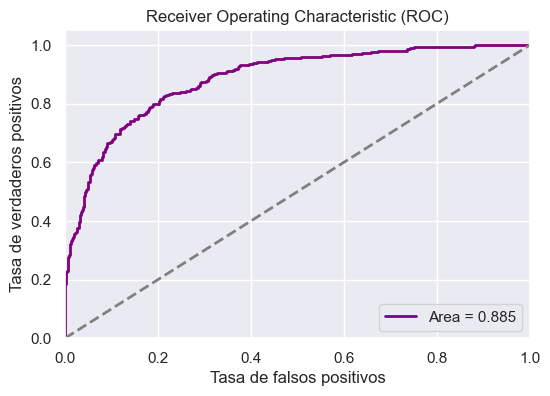

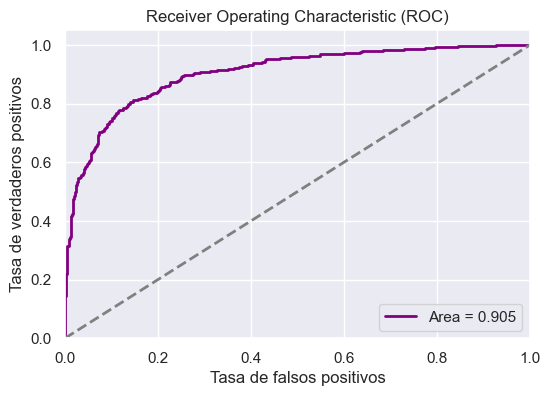

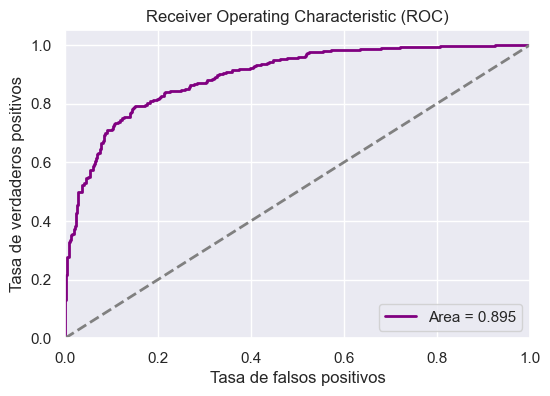

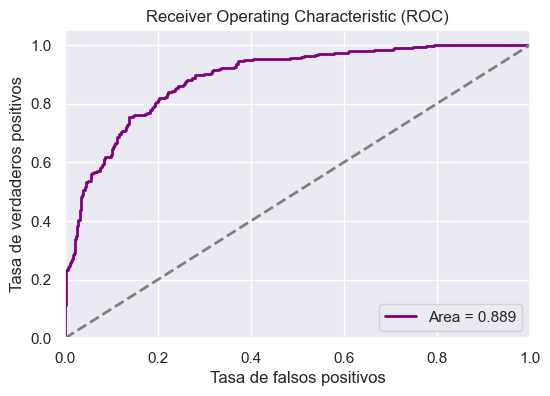

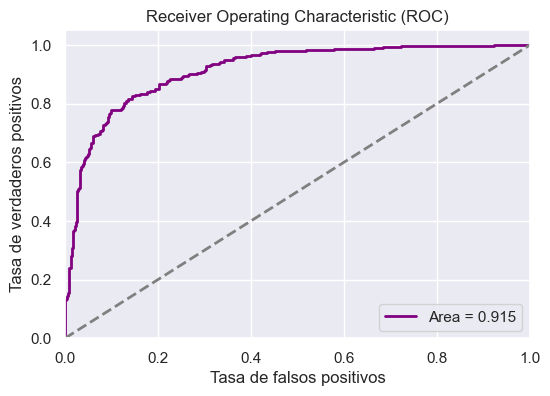

...

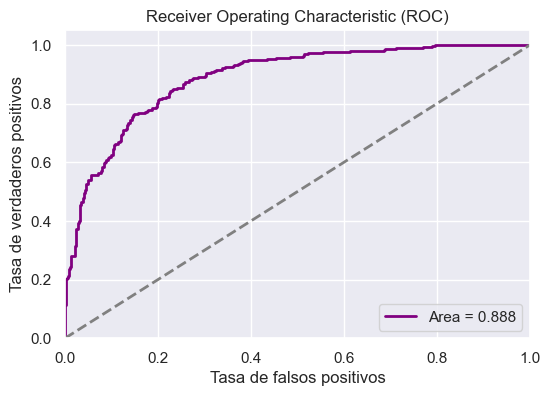

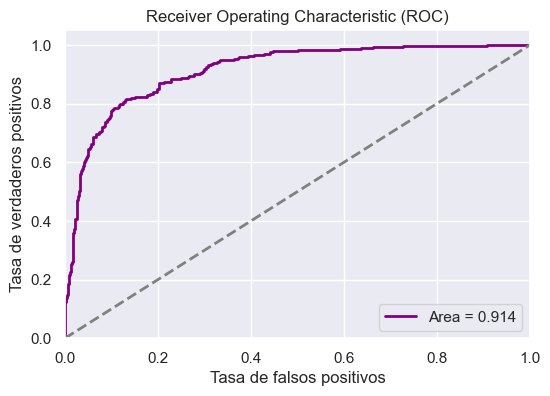

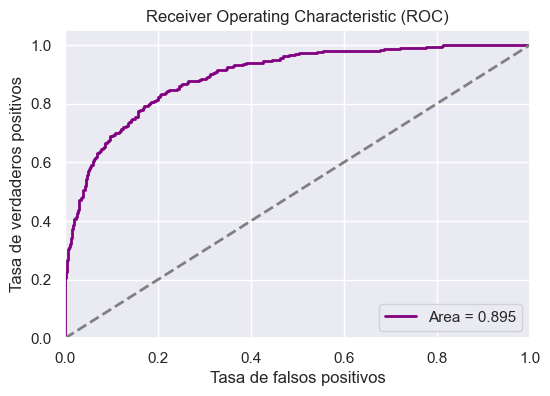

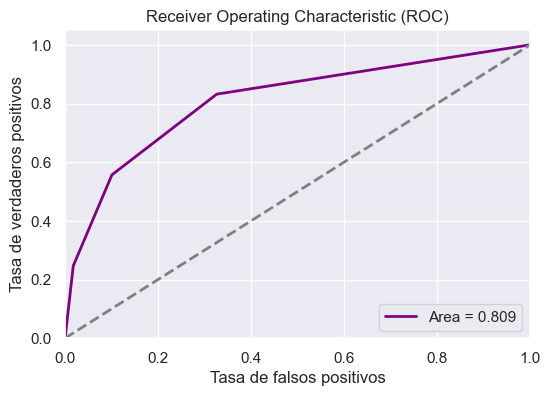

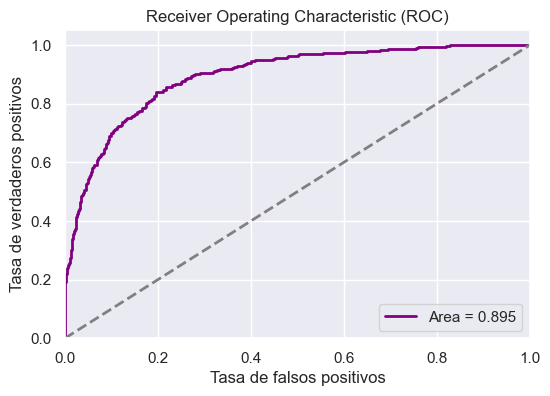

In [23]:
# Realizamos una prueba con hiperparámetros definidos.

evalua_multiples_metodos(5, 20, X, y) # X_train, X_test , Y_train, Y_test

#### 3. Expliquen cómo elegirían <i>λ</i> por validación cruzada. Detallen por qué no usarían el conjunto de prueba (test) para su elección.

La elección de λ se aborda mediante la técnica de validación cruzada K-Fold con el propósito de minimizar el error de predicción fuera de la muestra. Se consideran varios valores alternativos de λ y se calcula el error de pronóstico al dividir los datos en K partes de manera aleatoria, dejando al azar algunas de estas partes fuera del proceso de ajuste del modelo. El valor de λ que ofrece el mejor rendimiento en términos de predicciones se selecciona como el óptimo.
<br>

No se recurre a los datos del conjunto de prueba (test) para esta elección. Esto se debe a que la utilización de los datos de prueba para estimar el modelo sería incorrecta, ya que podría llevar a un sobreajuste (<b>overfitting</b>) y posiblemente introducir sesgos en las predicciones. 

Es decir, los datos de prueba se reservan para evaluar el rendimiento del modelo final en una muestra independiente; no deben utilizarse en el proceso de selección de hiperparámetros, como λ, para garantizar una evaluación imparcial del modelo en datos nuevos.

#### 4. En validación cruzada, ¿cúal es el problema de usar un <i>k</i> muy pequeño y uno muy grande? Cuando <i>k = n</i> (con <i>n</i> el número de muestras), ¿cúantas veces se estima el modelo?

La elección del valor de 𝐾 en la validación cruzada es crucial para obtener una estimación precisa de λ. Un valor grande de 𝐾 maximiza la cantidad de datos utilizados para estimar el modelo en cada iteración, lo que lo hace sensible a las particularidades de los datos, ya que depende en gran medida de cómo se comporta el modelo con un conjunto limitado de datos de prueba. Esto puede llevar a una estimación inestable y sesgada del error.

Por otro lado, un valor pequeño de 𝐾 maximiza la cantidad de datos utilizados para evaluar el modelo estimado en cada iteración. Sin embargo, esto puede resultar en estimaciones menos precisas, ya que se evalúa el modelo con un conjunto más limitado de datos de prueba en cada iteración.

En casos extremos, cuando 𝐾 se establece igual a 𝑛 (leave one out), el modelo se estima 𝑛 veces, dejando un solo dato fuera en cada iteración. Esto proporciona una estimación muy precisa del rendimiento del modelo, pero a costa de un alto costo computacional, ya que se repite el proceso 𝑛 veces.

#### 5. Realicen un barrido en <i>λ = 10^n </i> con <i>n</i> ∈ {−5,−4,−3 . . . , +4, +5} y utilicen 10 fold CV para elegir el <i>λ</i> óptimo en regresión logística con Ridge y con LASSO. ¿Qué <i>λ</i> seleccionó en cada caso? Generen <a href="https://matplotlib.org/3.1.1/api/_as_gen/matplotlib.pyplot.boxplot.html" > box-plots </a> mostrando la distribución del error de predicción para cada <i>λ</i>. Cada box debe corresponder a un valor de <i>λ</i> y contener como observaciones el error medio de validación para cada partición. Además, para la regularización LASSO, genere un box-plot similar, pero ahora graficando la proporción de variables ignoradas por el modelo en función de <i>λ</i>, es decir la proporción de variables para las cuales el coeficiente asociado es cero.

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

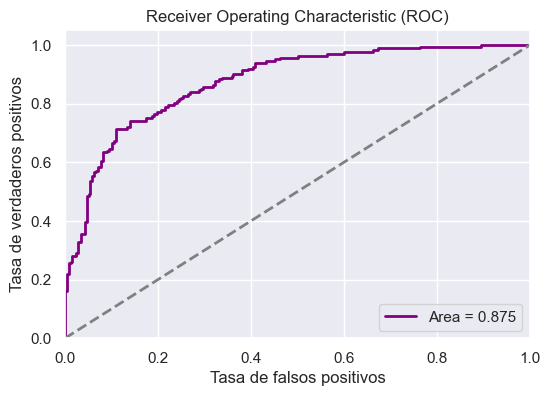

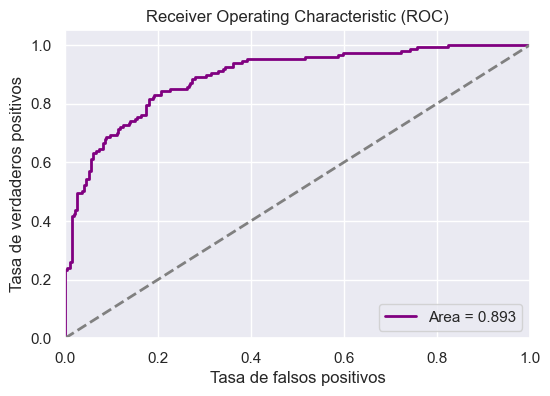

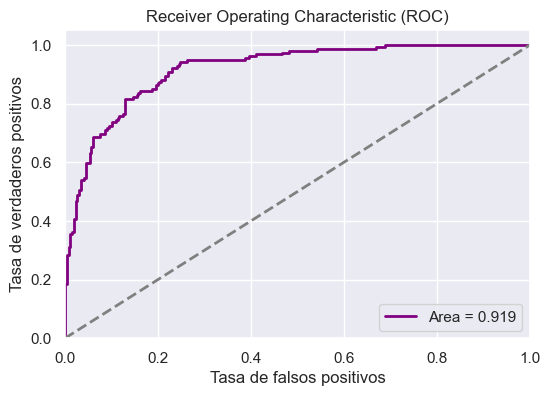

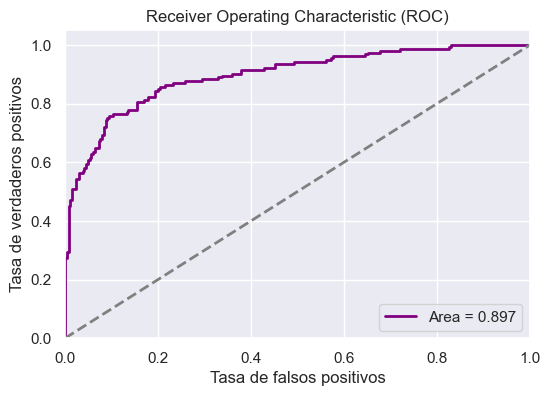

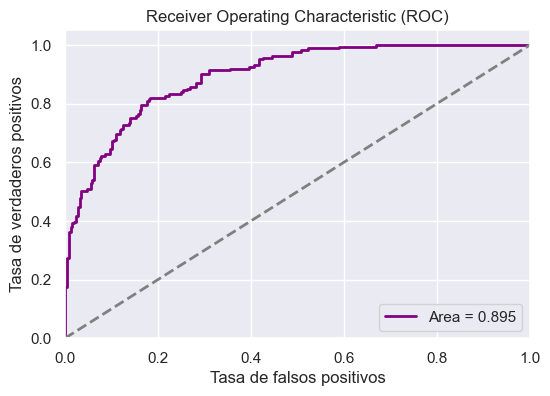

...

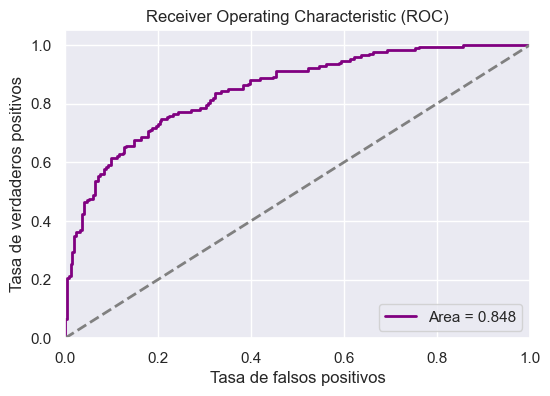

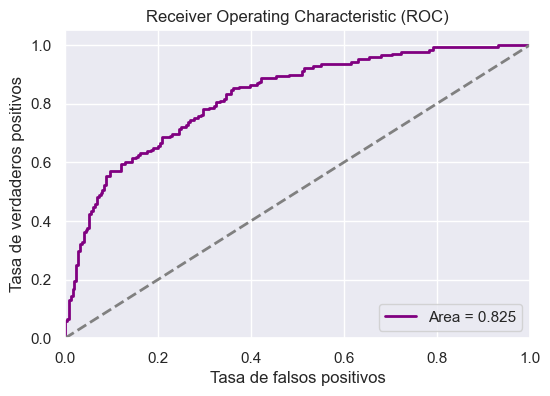

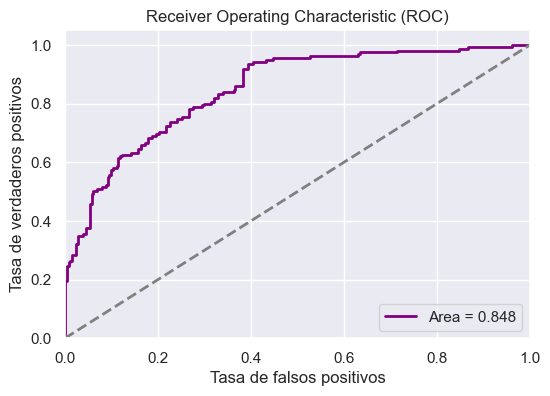

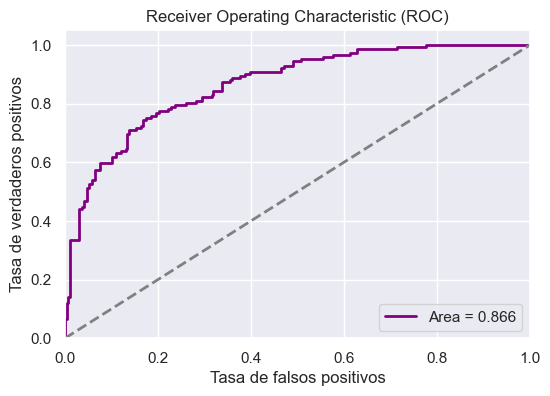

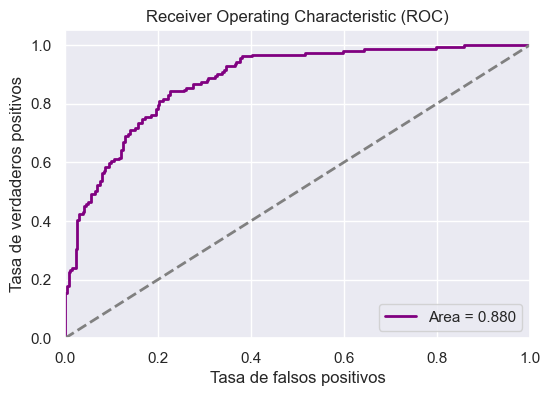

In [24]:
landas=10**np.linspace(-5,5,11) # Definimos los lambdas.
lassocv = evalua_config(landas, 10, X, y, l1_ratio=1) # Aplicamos LASSSO
ridgecv = evalua_config(landas, 10, X, y, l1_ratio=0) # Apicamos Ridge

In [25]:
# Analizamos los ECMs de ambos métodos con cada parámetro, para identificar el óptimo

print(lassocv[2])
print(ridgecv[2])

                                                  ecm  ecm_mean     parametro
0   [0.18899521531100477, 0.17703349282296652, 0.1...  0.170139       0.00001
1   [0.18899521531100477, 0.17703349282296652, 0.1...  0.170139       0.00010
2   [0.18899521531100477, 0.17703349282296652, 0.1...  0.170139       0.00100
3   [0.18899521531100477, 0.17703349282296652, 0.1...  0.170139       0.01000
4   [0.18899521531100477, 0.17703349282296652, 0.1...  0.170379       0.10000
5   [0.18899521531100477, 0.17942583732057416, 0.1...  0.171097       1.00000
6   [0.18421052631578946, 0.17942583732057416, 0.1...  0.170859      10.00000
7   [0.18421052631578946, 0.18899521531100477, 0.1...  0.182360     100.00000
8   [0.38516746411483255, 0.35167464114832536, 0.3...  0.372638    1000.00000
9   [0.38516746411483255, 0.35167464114832536, 0.3...  0.372638   10000.00000
10  [0.38516746411483255, 0.35167464114832536, 0.3...  0.372638  100000.00000
                                                  ecm  ecm_mean 

In [28]:
# Formateamos los outputs para poder visualizarlos
lassocv_graphic=lassocv[2]

# Crear un DataFrame con las columnas deseadas
ecm = pd.DataFrame(columns=["ecm_1", "ecm_2", "ecm_3", "ecm_4", "ecm_5", "ecm_6", "ecm_7", "ecm_8", "ecm_9", "ecm_10"])

# Supongamos que lassocv_graphic['ecm'][1] contiene una lista de valores
for i in range(len(lassocv_graphic['ecm'])):
  valores_ecm = lassocv_graphic['ecm'][i]
  # Crear una nueva fila en el DataFrame ecm
  ecm.loc[i] = valores_ecm

drop_ecm = ['ecm','ecm_mean']
lassocv_graphic = pd.concat([lassocv_graphic, ecm], axis=1)
lassocv_graphic = lassocv_graphic.drop(drop_ecm, axis=1)

lassocv_long = pd.melt(lassocv_graphic, id_vars=['parametro'], var_name='ECM', value_name='Valor')

Text(0, 0.5, 'ECM')

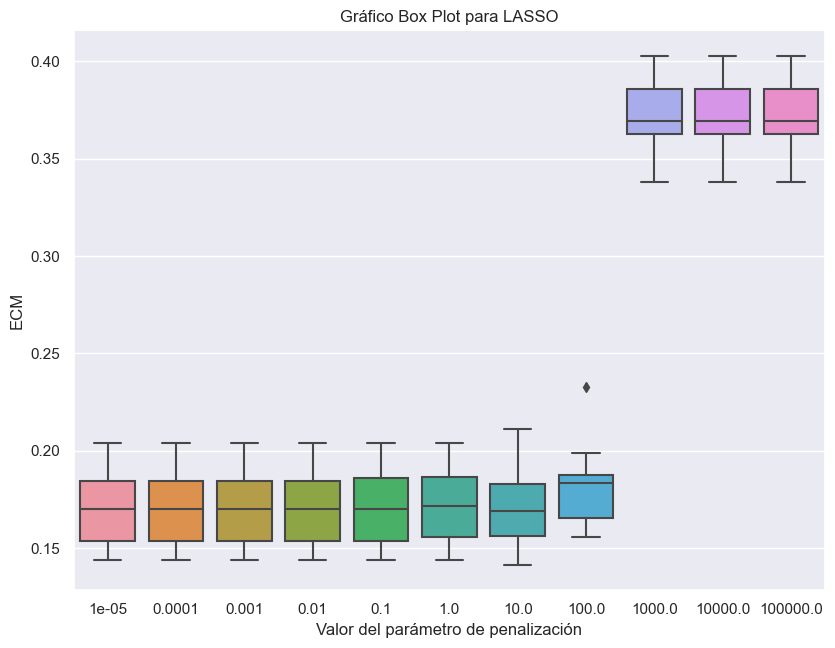

In [29]:
# Creamos el box plot
sns.set(rc={'figure.figsize':(9.7,7.27)})
ax = sns.boxplot(data=lassocv_long, x="parametro", y="Valor")
ax.set_title("Gráfico Box Plot para LASSO")
ax.set_xlabel("Valor del parámetro de penalización")
ax.set_ylabel("ECM")


Para LASSO, podemos ver que los ECMs se mantienen bastante estables para los valores chicos de λ, pero a partir del λ = 1000, estos se disparan.
<br>

Gráficamente, no resulta obvio cuál es el valor de λ que minimiza el ECM.

In [30]:
ridgecv_graphic=ridgecv[2]

# Crear un DataFrame con las columnas deseadas
ecm = pd.DataFrame(columns=["ecm_1", "ecm_2", "ecm_3", "ecm_4", "ecm_5", "ecm_6", "ecm_7", "ecm_8", "ecm_9", "ecm_10"])

# Supongamos que lassocv_graphic['ecm'][1] contiene una lista de valores
for i in range(len(ridgecv_graphic['ecm'])):
  valores_ecm = ridgecv_graphic['ecm'][i]
  # Crear una nueva fila en el DataFrame ecm
  ecm.loc[i] = valores_ecm

drop_ecm = ['ecm','ecm_mean']
ridgecv_graphic = pd.concat([ridgecv_graphic, ecm], axis=1)
ridgecv_graphic = ridgecv_graphic.drop(drop_ecm, axis=1)

ridgecv_long = pd.melt(ridgecv_graphic, id_vars=['parametro'], var_name='ECM', value_name='Valor')

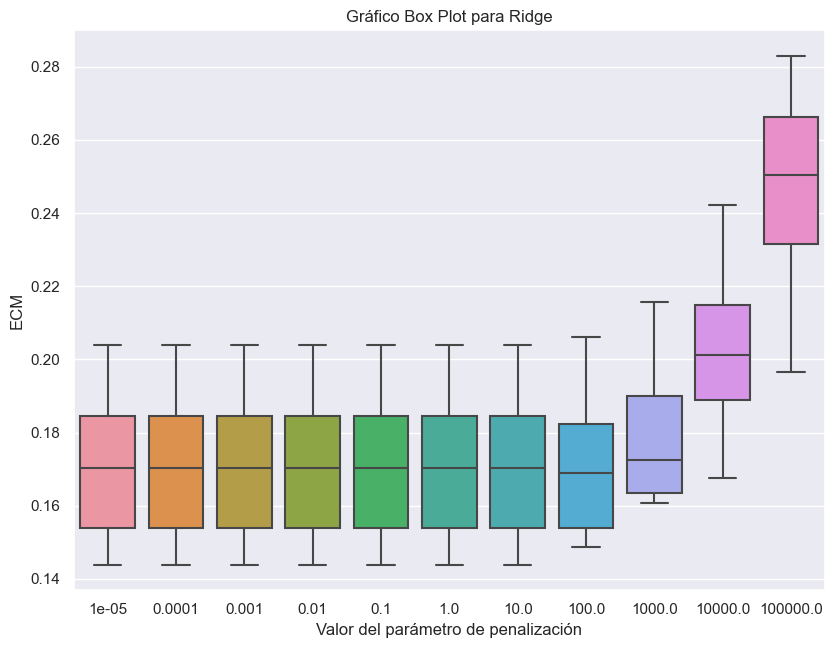

In [31]:

# Crear el box plot
sns.set(rc={'figure.figsize':(9.7,7.27)})
box_plot = sns.boxplot(data=ridgecv_long, x="parametro", y="Valor")
box_plot.set(title="Gráfico Box Plot para Ridge")
box_plot.set(xlabel="Valor del parámetro de penalización")
box_plot.set(ylabel="ECM")

plt.show()

Para Ridge, podemos ver que los ECMs se mantienen bastante estables para los valores chicos de λ, pero a partir del λ = 1000, estos se disparan.
<br>

Al igual que para LASSO, gráficamente no resulta obvio cuál es el valor de λ que minimiza el ECM.

In [32]:
def evalua_metodo_c(X_train, X_test, Y_train, Y_test, modelo, landa=1):
    
    y = modelo.fit(X_train, Y_train)
    coef = y.coef_

    return coef

In [33]:
def cross_validation_c(modelo, k, X, y):
    
    sc = StandardScaler()

    kf = KFold(n_splits=k, shuffle=True, random_state=201)

    coef = []

    for i, (train_index, test_index) in enumerate(kf.split(X)):
        X_train, X_test = X.iloc[list(train_index)], X.iloc[list(test_index)]
        Y_train, Y_test = y.iloc[list(train_index)], y.iloc[list(test_index)]

        # Estandarizamos las observaciones de entrenamiento
        X_train_transformed = pd.DataFrame(sc.fit_transform(X_train),index=X_train.index, columns=X_train.columns)
        # Estandarizamos las observaciones de test
        X_test_transformed = pd.DataFrame(sc.transform(X_test),index=X_test.index, columns=X_test.columns)

        coef2 = evalua_metodo_c(X_train_transformed, X_test_transformed, Y_train, Y_test, modelo)
        coef3 = coef2
        coef.append(coef3)

    return coef

In [34]:
def evalua_config_c(landa, k, X, y, l1_ratio=1): #modelo

    ret=pd.DataFrame(columns=["coeficientes","parametro"])

    for i in range(len(landa)):
        clf_en_LR = LogisticRegression(C=1/landa[i], penalty="elasticnet",
                                      solver="saga", l1_ratio=l1_ratio, tol=0.01, random_state=201)
        coeficientes  = cross_validation_c(clf_en_LR, k, X, y)
        ret.loc[i]= [coeficientes, landa[i]]

    return ret

In [35]:
landas=10**np.linspace(-5,5,11)
lassocv_c = evalua_config_c(landas, 10, X, y, l1_ratio=1)

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

In [36]:
print(lassocv_c['coeficientes'][7])

[array([[ 0.        , -0.04947645, -0.03705808, -0.04957856,  0.        ,
         0.03227356,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.18632491,  0.1171226 ,  0.13484697,
         0.02965806, -0.02842448,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        , -0.07807937,
         0.0884436 ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        , -0.0197351 ,  0.0197351 ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        , -0.02123867,  0.02708176,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.

In [37]:
# Creamos la función que calcula la proporción de coeficientes regularizados a 0

def proporcion_de_ceros(arr):
    total_elementos = arr.size
    ceros = (arr == 0).sum()
    proporcion = ceros / total_elementos
    return proporcion

In [38]:
prop_l = {}

# Supongamos que lassocv['coeficientes'] es una lista de listas de coeficientes
for i, coef_lista in enumerate(lassocv_c['coeficientes']):
    prop_k = []
    for j, coef in enumerate(coef_lista):
        prop_k.append(proporcion_de_ceros(coef))
    prop_l[i] = prop_k

proporciones_coef = pd.DataFrame(prop_l).T
lassocv_c = pd.concat([lassocv_c, proporciones_coef], axis=1)

In [39]:
lassocv_graphic=lassocv_c

drop_coef = ['coeficientes']
lassocv_graphic = lassocv_graphic.drop(drop_coef, axis=1)

lassocv_long = pd.melt(lassocv_graphic, id_vars=['parametro'], var_name='COEF', value_name='Valor')

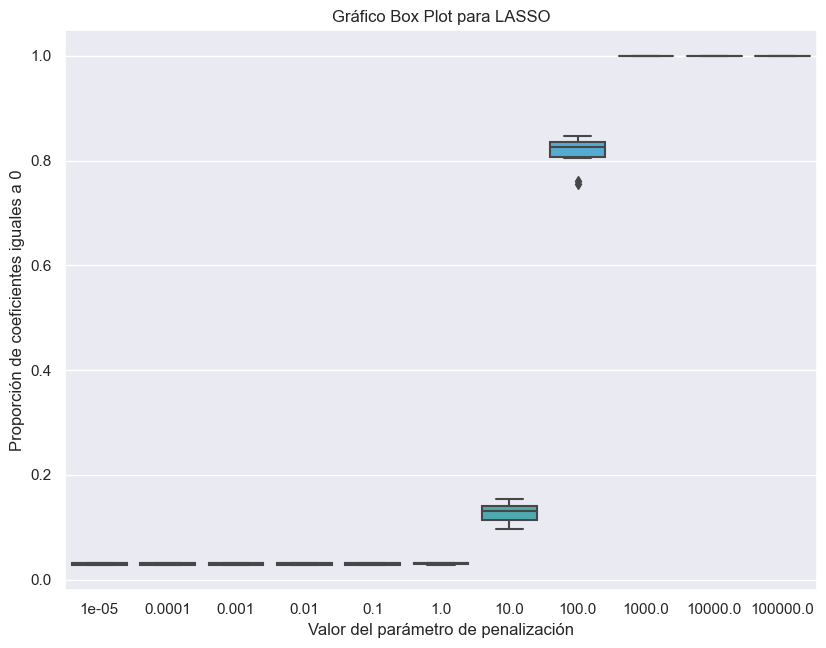

In [40]:
# Crear el box plot
sns.set(rc={'figure.figsize': (9.7, 7.27)})
box_plot = sns.boxplot(data=lassocv_long, x="parametro", y="Valor")

# Set the title, x-axis label, and y-axis label
box_plot.set(title="Gráfico Box Plot para LASSO")
box_plot.set(xlabel="Valor del parámetro de penalización")
box_plot.set(ylabel="Proporción de coeficientes iguales a 0")

plt.show()

Podemos apreciar que solamente a partir del λ = 10 podemos apreciar gráficamente una proporción significativa de coeficientes regularizados a 0.

#### 6.  En el caso del valor óptimo de <i>λ</i> para LASSO encontrado en el inciso anterior, ¿qué variables fueron descartadas? ¿Son las que hubieran esperado? ¿Tiene relación con lo que respondieron en el inciso 1 de la Parte I?

Para el método LASSO, obtenemos un λ que minimiza el ECM de valor 10e-05 con un ECM 0.170, descartando a penas 9 variables: 
<br>

1. intercepto
<br>

2. IV2_9
<br>

3. IV4_7
<br>

4. IV10_3
<br>
5. ESTADO_0
<br>
6. CAT_OCUP_9
<br>
7. PP02C8_1
<br>
8. PP02E_1
<br>
9. PP02E_2

<br>

Comparando con el inciso 1 de la Parte I, vemos que no se descartaron variables que consideramos relevantes, validando nuestras intuiciones.

In [41]:
# Analizamos los coeficientes con el lambda = 0.00001

print(lassocv_long.loc[lassocv_long['parametro']== 0.00001])

# Vemos que el lambda optimo puede hacer cero diferentes coeficientes en diferentes particiones
 
# Solo analizamos la primera partición para interpretar
print(pd.Series(lassocv_c['coeficientes'][0][0][0], index = X.columns)[:60])
print(pd.Series(lassocv_c['coeficientes'][0][0][0], index = X.columns)[61:120])
print(pd.Series(lassocv_c['coeficientes'][0][0][0], index = X.columns)[121:180])
print(pd.Series(lassocv_c['coeficientes'][0][0][0], index = X.columns)[181:240])
print(pd.Series(lassocv_c['coeficientes'][0][0][0], index = X.columns)[241:])

    parametro COEF     Valor
0     0.00001    0  0.032028
11    0.00001    1  0.032028
22    0.00001    2  0.032028
33    0.00001    3  0.028470
44    0.00001    4  0.032028
55    0.00001    5  0.032028
66    0.00001    6  0.028470
77    0.00001    7  0.028470
88    0.00001    8  0.028470
99    0.00001    9  0.032028
intercepto    0.000000
CH06         -0.049490
CH12         -0.076304
NIVEL_ED     -0.075916
II1          -0.015867
II2           0.090704
II3_1        -0.005637
II3_1        -0.010091
II5_1         0.017615
II5_1        -0.004981
II6_1         0.007801
II6_1         0.017346
IX_TOT        0.187816
IX_MEN10      0.144413
IX_MAYEQ10    0.153087
IV1_1         0.073391
IV1_2        -0.071229
IV1_3        -0.025458
IV1_4        -0.014196
IV1_6         0.010839
IV2_1         0.002130
IV2_2         0.011551
IV2_3         0.012151
IV2_4        -0.004915
IV2_5        -0.032652
IV2_6        -0.035287
IV2_7        -0.000794
IV2_8         0.040092
IV2_9         0.000000
IV3_1        -

In [42]:
# Analizamos los coeficientes con el lambda = 100

print(lassocv_long.loc[lassocv_long['parametro']== 100])

# Vemos que el lambda optimo puede hacer cero diferentes coeficientes en diferentes particiones
 
# Solo analizamos la primera partición para interpretar
print(pd.Series(lassocv_c['coeficientes'][7][0][0], index = X.columns)[:60])
print(pd.Series(lassocv_c['coeficientes'][7][0][0], index = X.columns)[61:120])
print(pd.Series(lassocv_c['coeficientes'][7][0][0], index = X.columns)[121:180])
print(pd.Series(lassocv_c['coeficientes'][7][0][0], index = X.columns)[181:240])
print(pd.Series(lassocv_c['coeficientes'][7][0][0], index = X.columns)[241:])

     parametro COEF     Valor
7        100.0    0  0.754448
18       100.0    1  0.818505
29       100.0    2  0.846975
40       100.0    3  0.839858
51       100.0    4  0.836299
62       100.0    5  0.814947
73       100.0    6  0.832740
84       100.0    7  0.804270
95       100.0    8  0.761566
106      100.0    9  0.832740
intercepto    0.000000
CH06         -0.049476
CH12         -0.037058
NIVEL_ED     -0.049579
II1           0.000000
II2           0.032274
II3_1         0.000000
II3_1         0.000000
II5_1         0.000000
II5_1         0.000000
II6_1         0.000000
II6_1         0.000000
IX_TOT        0.186325
IX_MEN10      0.117123
IX_MAYEQ10    0.134847
IV1_1         0.029658
IV1_2        -0.028424
IV1_3         0.000000
IV1_4         0.000000
IV1_6         0.000000
IV2_1         0.000000
IV2_2         0.000000
IV2_3         0.000000
IV2_4         0.000000
IV2_5         0.000000
IV2_6         0.000000
IV2_7         0.000000
IV2_8         0.000000
IV2_9         0.000000
IV3

Para un λ igual a 100, vemos que se droppean las siguientes variables intercepto, II1, II3_1, II3_1, II5_1, II5_1, II6_1, II6_1, IV1_3, IV1_4, IV1_6, IV2_1, IV2_2, IV2_3, IV2_4, IV2_5, IV2_6, IV2_7, IV2_8, IV2_9, IV3_3, IV3_4, IV4_1, IV4_2, IV4_3, IV4_4, IV4_5, IV4_6, IV4_7, IV4_9, IV6_1, IV6_2, IV6_3, IV7_1, IV7_2, IV7_3, IV7_4, IV8_1, IV8_2, IV9_0, IV9_1, IV9_2, IV9_3, IV9_4, V1_1, V1_2, V1_9, V2_1, V2_2, V2_9, V21_1, V21_2, V22_1, V3_1, V3_2, V3_9, V4_1, V4_2, V4_9, V5_9, V6_9, V7_9, V8_1, V8_2, V8_9, V9_1, V9_2, V9_9, V10_1, V10_2, V10_9, V11_9, V12_9, V13_1, V13_2, V13_9, V14_9, V15_1, V15_2, V15_9, V16_9, V17_9, V18_1, V18_2, V18_9, V19_A_2, V19_A_9, V19_B_2, V19_B_9, CH03_1, CH03_2, CH03_4, CH03_5, CH03_6, CH03_7, CH03_9, CH03_10, CH04_1, CH04_2, CH07_1, CH07_2, CH07_3, CH07_4, CH07_5, CH07_9, CH08_3, CH08_9, CH09_1, CH09_2, CH09_3, CH10_0, CH10_2, CH10_3, CH10_9, CH11_2, CH11_9, CH13_0, CH13_1, CH13_2, CH15_1, CH15_2, CH15_3, CH15_4, CH15_5, CH15_9, CH16_0, CH16_1, CH16_2, CH16_3, CH16_4, CH16_5, CH16_6, CH16_9, ESTADO_0, ESTADO_3, ESTADO_4, CAT_OCUP_1, CAT_OCUP_2, CAT_OCUP_4, CAT_OCUP_9, CAT_INAC_0, CAT_INAC_2, CAT_INAC_5, CAT_INAC_6, CAT_INAC_7, PP02C1_1, PP02C2_1, PP02C2_2, PP02C3_1, PP02C3_2, PP02C4_1, PP02C4_2, PP02C5_1, PP02C6_1, PP02C6_2, PP02C7_1, PP02C8_1, PP02E_0, PP02E_1, PP02E_2, PP02E_3, PP02E_4, PP02E_5, PP02H_0, PP02H_2, PP02I_0, PP02I_1, PP02I_2.

#### 7. Elijan alguno de los modelos de regresión logística donde hayan probado distintos parámetros de regularización y comenten: ¿Qué método de regularización funcionó mejor Ridge o LASSO? Comenten mencionando el error cuadrático medio (ECM).

In [43]:
print(f'El λ elegido con Lasso es {lassocv[1]} y  el ecm es {lassocv[0]}.')
print(f'El λ elegido con Ridge es {ridgecv[1]} y  el ecm es {ridgecv[0]}.')

El λ elegido con Lasso es 1e-05 y  el ecm es 0.17013929526235472.
El λ elegido con Ridge es 100.0 y  el ecm es 0.16990120822002686.


De acuerdo a nuestros resultados, vemos que el mejor método es el de Ridge, con un λ = 100 y un ECM de 0.1699, contra el LASSO con λ = 1e-05 y ECM = 0.1701.
<br>

Sin embargo, estas son diferencias mínimas.


#### 8. ¿Cúal de todos los métodos evaluados predice mejor? ¿Con qué hiperparámetros? Justifiquen detalladamente utilizando las medidas de precisión que conocen.

Considerando el Error Cuadrático Medio, el modelo Ridge con λ = 100 parece ligeramente mejor que el modelo Lasso con λ = 0.0001. Se busca el modelo con el ECM más bajo, ya que indica que el modelo tiene un mejor rendimiento en la predicción.



C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


,modelo,matriz de confusion,accuracy,auc,ecm
0,"LogisticRegression(C=0.01, l1_ratio=0, penalty...","[[684, 110], [107, 351]]",0.827,0.896,0.173323


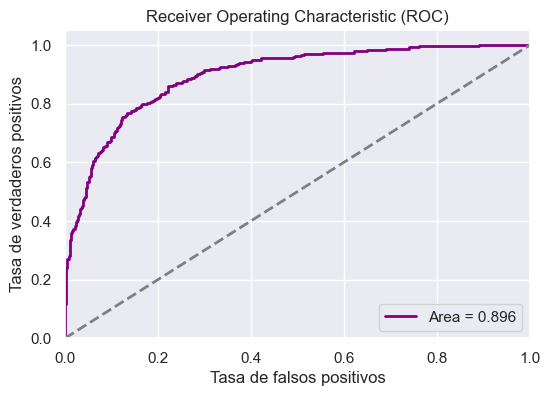

In [44]:
# Seteamos las variables

X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.3, random_state=201)
sc = StandardScaler()

# Estandarizamos las observaciones de entrenamiento
X_train_transformed = pd.DataFrame(sc.fit_transform(X_train),index=X_train.index, columns=X_train.columns)
X_test_transformed = pd.DataFrame(sc.fit_transform(X_test),index=X_test.index, columns=X_test.columns)

# Definimos al modelo óptimo

modelo = LogisticRegression(C=1/100, penalty="elasticnet",solver="saga", l1_ratio=0, tol=0.01, random_state=201).fit(X_train_transformed, Y_train)



evalua_metodo(X_train_transformed, X_test_transformed, Y_train, Y_test, modelo)

Si comparamos con los resultados con los del inciso 2) de la parte III, podemos ver que nuestro modelo óptimo le gana en todas las métricas:
<br>

En el inciso 2, obtenemos:

<table>
  <tr>
    <th>Modelo</th>
    <th>Hiperparametro</th>
    <th>Matriz de confusión</th>
    <th>Precisión</th>
    <th>AUC</th>
    <th>ECM</th>
  </tr>
  <tr>
    <td>Regresion logistica</td>
    <td>10.01</td>
    <td>[[703, 91], [137, 321]]</td>
    <td>0.818</td>
    <td>0.895</td>
    <td>0.182109</td>
  </tr>
  <tr>
    <td>K vecinos mas cercanos</td>
    <td>3.00</td>
    <td>[[714, 80], [203, 255]]</td>
    <td>0.774</td>
    <td>0.809</td>
    <td>0.226038</td>
  </tr>
  <tr>
    <td>Analisis discriminante</td>
    <td>1.00</td>
    <td>[[719, 75], [146, 312]]</td>
    <td>0.823</td>
    <td>0.895</td>
    <td>0.176518</td>
  </tr>
</table>


<br>

Con nuestro modelo obtenemos:

<table border="1">
  <thead>
    <tr>
      <th>Modelo</th>
      <th>Matriz de confusion</th>
      <th>Accuracy</th>
      <th>AUC</th>
      <th>ECM</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <td>LogisticRegression(C=0.01, l1_ratio=0, penalty... </td>
      <td>[[684, 110], [107, 351]]</td>
      <td>0.827</td>
      <td>0.896</td>
      <td>0.173323</td>
    </tr>
  </tbody>
</table>




#### 9. Con el método que seleccionaron, predigan qué personas son pobres dentro de la base <i>norespondieron</i>. ¿Qué proporción de los hogares son pobres en esa submuestra?

In [45]:
# Identificamos las columnas a droppear.

drop_gang = ['CODUSU','ANO4_x','TRIMESTRE_x','NRO_HOGAR','COMPONENTE','H15','REGION_x',
            'AGLOMERADO_x','PONDERA_x','MAS_500_x','REALIZADA','CH05','ITF_x','DECIFR_x',
            'RDECIFR_x','GDECIFR_x','ADECIFR_x','IPCF_x','DECCFR_x','RDECCFR_x',
            'GDECCFR_x','ADECCFR_x','PONDIH_x','P21','DECOCUR','RDECOCUR','GDECOCUR',
            'ADECOCUR','PONDIIO','TOT_P12','P47T','DECINDR','RDECINDR','GDECINDR',
            'ADECINDR','PONDII',"V2_M","V3_M","V4_M","V5_M","V8_M","V9_M","V10_M",
            "V11_M","V12_M","V18_M","V19_AM","V21_M","T_VI",'adulto_equiv','ad_equiv_hogar',
            'IV1','IV2','IV3','IV4','IV5','IV6','IV7','IV8','IV9','IV10',
            'IV11','IV12_1','IV12_2','IV12_3','II3','II4_1','II4_2','II4_3','II5',
            'II6','II7','II8','II9','V1','V2','V21','V22','V3','V4','V5','V6','V7',
            'V8','V9','V10','V11','V12','V13','V14','V15','V16','V17','V18','V19_A','V19_B',
            'VII1_1','VII1_2','VII2_1','VII2_2','VII2_3','VII2_4','CH03','CH04','CH07',
            'CH08','CH09','CH10','CH11','CH13','CH15','CH16','ESTADO','CAT_OCUP',
            'CAT_INAC','PP02C1','PP02C2','PP02C3','PP02C4','PP02C5','PP02C6','PP02C7',
            'PP02C8','PP02E','PP02H','PP02I']


# Eliminamos las variables de ambos dataframes 'respondieron' y 'norespondieron'.

norespondieron_drop = norespondieron.drop(drop_gang, axis=1)

sc = StandardScaler()
norespondieron_drop_transformed = pd.DataFrame(sc.fit_transform(norespondieron_drop),index=norespondieron_drop.index, columns=norespondieron_drop.columns)

In [46]:
#Predecimos con el modelo Logit sobre la base norespondieron, porque su Accuracy y Auc son mayores.
norespondieron_drop_transformed['intercepto'] = 1

norespondieron_drop_transformed = norespondieron_drop_transformed[['intercepto'] + [col for col in norespondieron_drop_transformed if col != 'intercepto']]

X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.3, random_state=201)

sc = StandardScaler()
# Estandarizamos las observaciones de entrenamiento
X_train_transformed = pd.DataFrame(sc.fit_transform(X_train),index=X_train.index, columns=X_train.columns)

modelo = LogisticRegression(C=1/100, penalty="elasticnet",solver="saga", l1_ratio=0, tol=0.01, random_state=201).fit(X_train_transformed, Y_train)

y_pred_nr = modelo.predict(norespondieron_drop_transformed)

pobres_nr=np.sum(y_pred_nr)
tasa_pobreza_nr=np.sum(y_pred_nr)/len(y_pred_nr)


print('\n',"La cantidad de pobres predicha en la muestra que no respondio es de:", pobres_nr, "de", len(y_pred_nr),'\n')
print("La tasa de pobreza predicha en la muestra de los que no respondieron es de:", round(tasa_pobreza_nr*100,2), "%")

C:\Users\cufa9\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)



 La cantidad de pobres predicha en la muestra que no respondio es de: 1274 de 3387 

La tasa de pobreza predicha en la muestra de los que no respondieron es de: 37.61 %
